In [3]:
from docling.datamodel.pipeline_options import PdfPipelineOptions
from docling.backend.pypdfium2_backend import PyPdfiumDocumentBackend
from docling.datamodel.base_models import InputFormat
from docling.document_converter import DocumentConverter, PdfFormatOption
from docling.chunking import HybridChunker

from transformers import AutoTokenizer

from pathlib import Path

In [4]:
# document local path or URL
doc = "./test_doc/test_textMore.pdf" # simple text with a image and table
doc1 = "./test_doc/吉美利101利率變動型美元終身壽險(定期給付型)DM.pdf" # complex text with simple aesthetic table
doc2 = "./test_doc/美利雙寶利率變動型美元終身保險 (定期給付型)DM.pdf" # complex text with complex aesthetic table
doc3 = "./test_doc/國泰金控出勤管理須知(修正後).pdf" # simple text with a simple table
doc4 = "./test_doc/國泰金控員工國內出差要點.pdf" # simple text with a simple table
doc5 = "./test_doc/國泰金控員工國外出差要點.pdf" # simple text with complex table
doc6 = "./test_doc/國泰金融控股股份有限公司資訊安全管理辦法.pdf" # simple text

# PyPdfium without EasyOCR
# --------------------
pipeline_options = PdfPipelineOptions()
pipeline_options.do_ocr = False
pipeline_options.do_table_structure = True
pipeline_options.table_structure_options.do_cell_matching = False
#pipeline_options.table_structure_options.do_cell_matching = True

#pipeline_options.table_structure_options.mode = 'accurate'

pipeline_options.images_scale = 2
pipeline_options.generate_page_images = True
pipeline_options.generate_picture_images = True

pypdfium_converter = DocumentConverter(
    format_options={
        InputFormat.PDF: PdfFormatOption(
        pipeline_options=pipeline_options, backend=PyPdfiumDocumentBackend
        )
    }
)

# Docling reader, docling format parser output

In [ ]:
doc_source = [doc, doc1, doc2, doc3, doc4, doc5, doc6]

conv_results = pypdfium_converter.convert_all(
    doc_source,
    raises_on_error=True,  # to let conversion run through all and examine results at the end
)

# Do hybrid chunking to merge similar chunk
tokenizer = AutoTokenizer.from_pretrained("BAAI/bge-m3")
#tokenizer = AutoTokenizer.from_pretrained("BAAI/bge-large-zh-v1.5")

hybrid_chunker = HybridChunker(
    tokenizer=tokenizer,
    merge_peers=True,  # optional, defaults to True
)

schema_name='DoclingDocument' version='1.1.0' name='test_textMore' origin=DocumentOrigin(mimetype='application/pdf', binary_hash=12873887059085029742, filename='test_textMore.pdf', uri=None) furniture=GroupItem(self_ref='#/furniture', parent=None, children=[], content_layer=<ContentLayer.FURNITURE: 'furniture'>, name='_root_', label=<GroupLabel.UNSPECIFIED: 'unspecified'>) body=GroupItem(self_ref='#/body', parent=None, children=[RefItem(cref='#/texts/0'), RefItem(cref='#/groups/0'), RefItem(cref='#/groups/1'), RefItem(cref='#/texts/13'), RefItem(cref='#/texts/14'), RefItem(cref='#/texts/15'), RefItem(cref='#/texts/16'), RefItem(cref='#/groups/2'), RefItem(cref='#/texts/29'), RefItem(cref='#/groups/3'), RefItem(cref='#/texts/33'), RefItem(cref='#/texts/34'), RefItem(cref='#/texts/35'), RefItem(cref='#/groups/4'), RefItem(cref='#/texts/37'), RefItem(cref='#/texts/38'), RefItem(cref='#/texts/39'), RefItem(cref='#/texts/40'), RefItem(cref='#/groups/5'), RefItem(cref='#/texts/42'), RefItem(
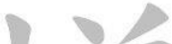
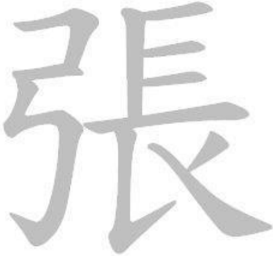
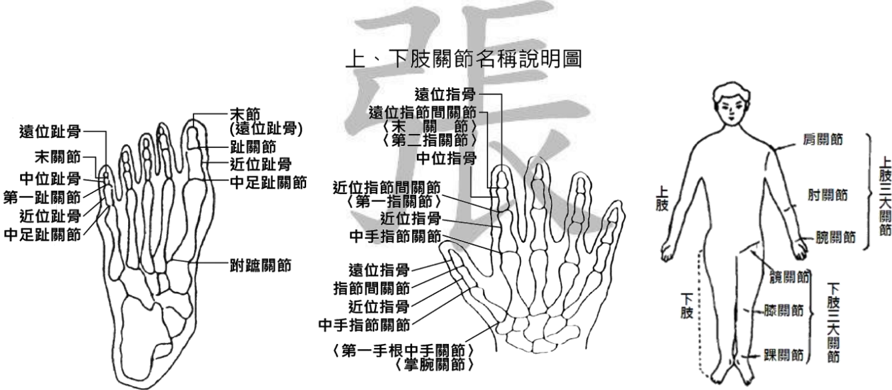
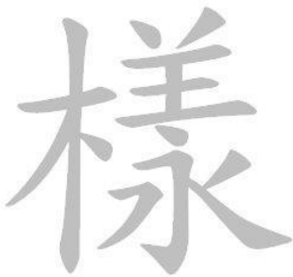
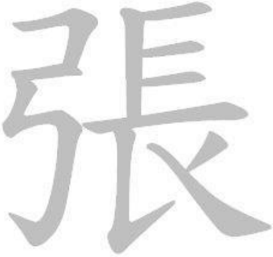
...
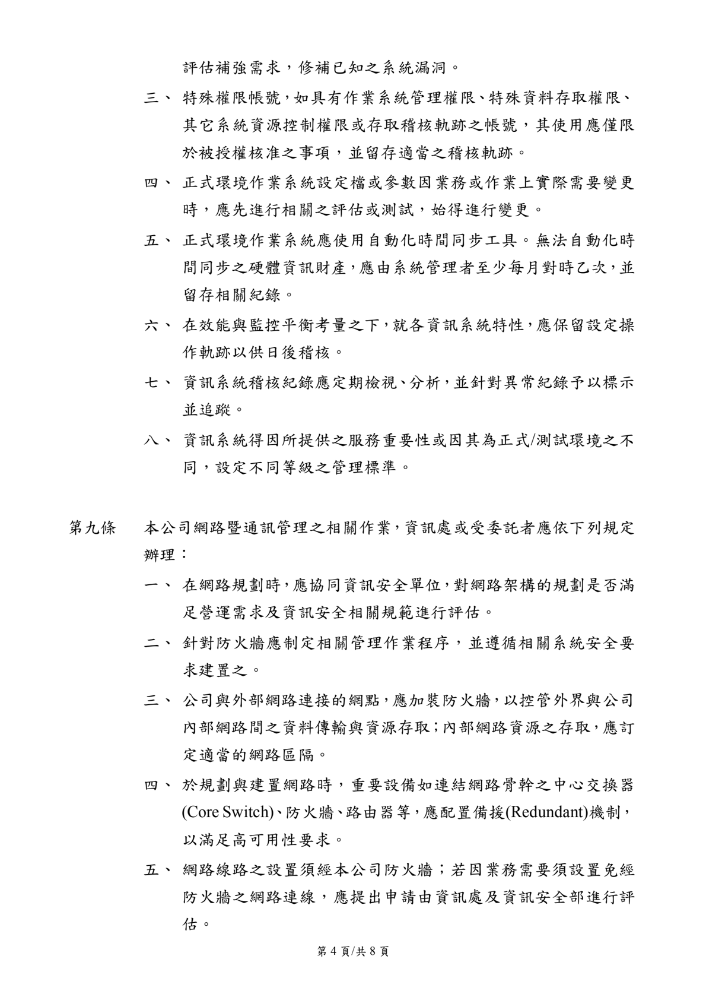
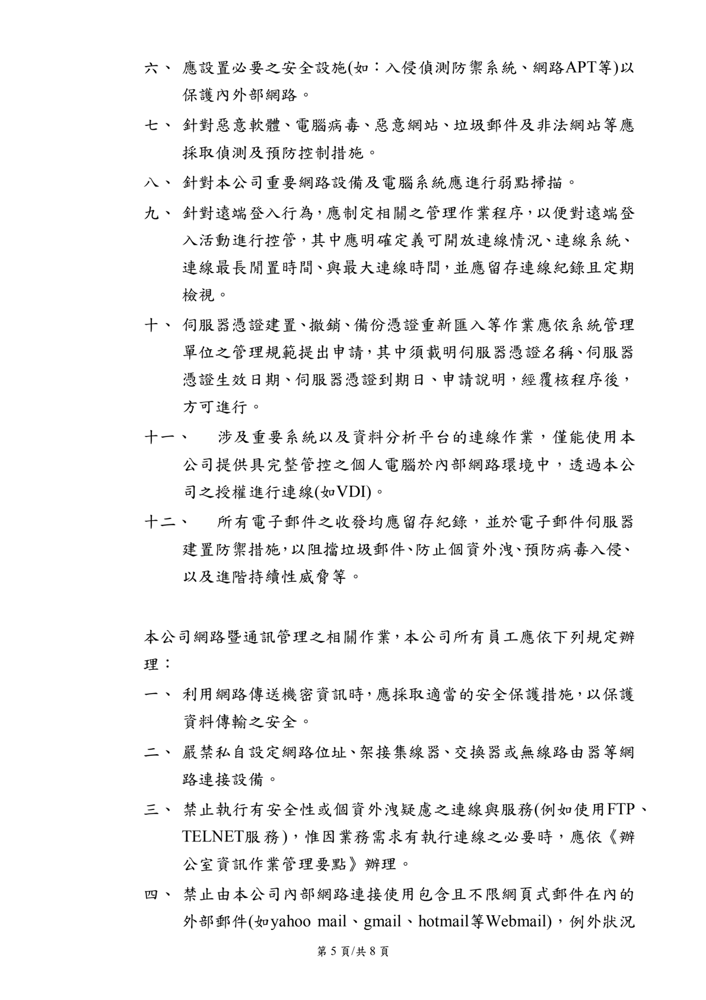
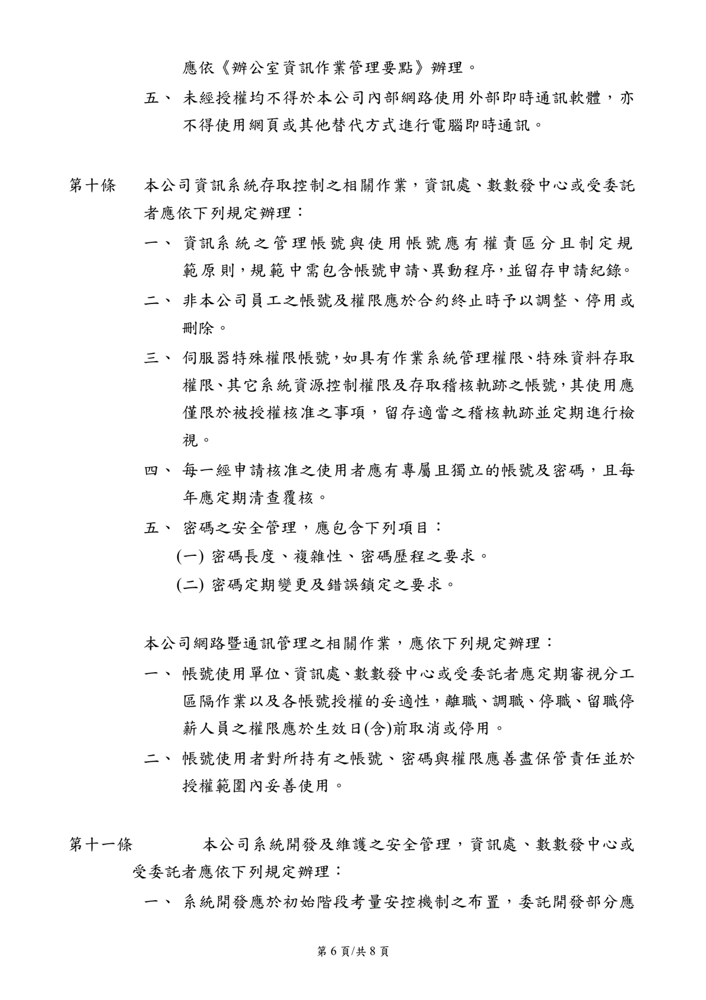
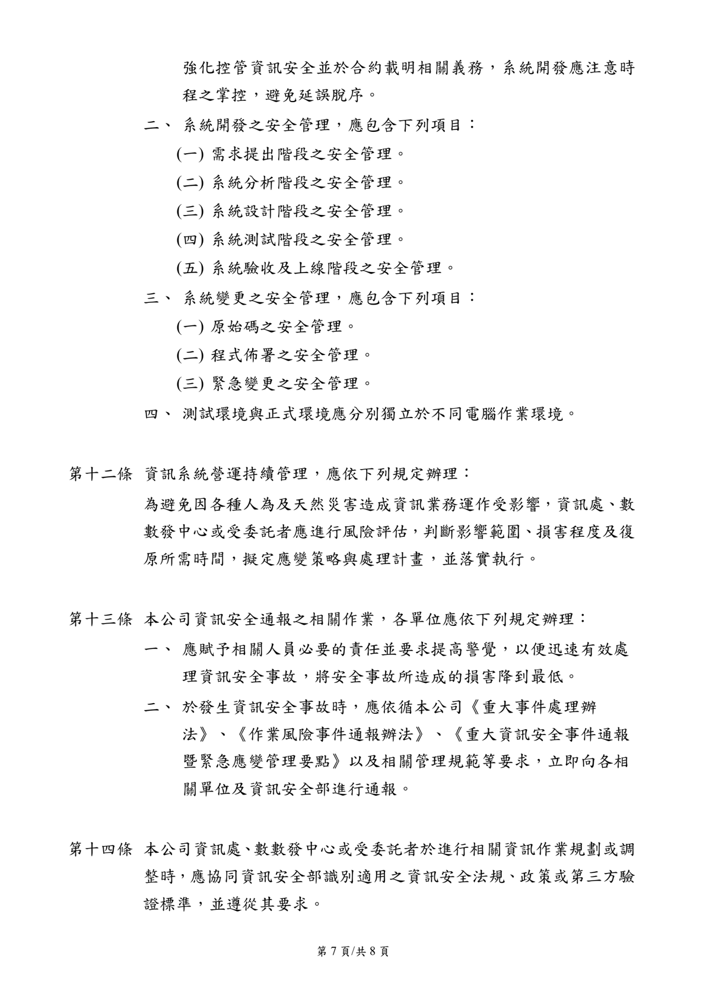
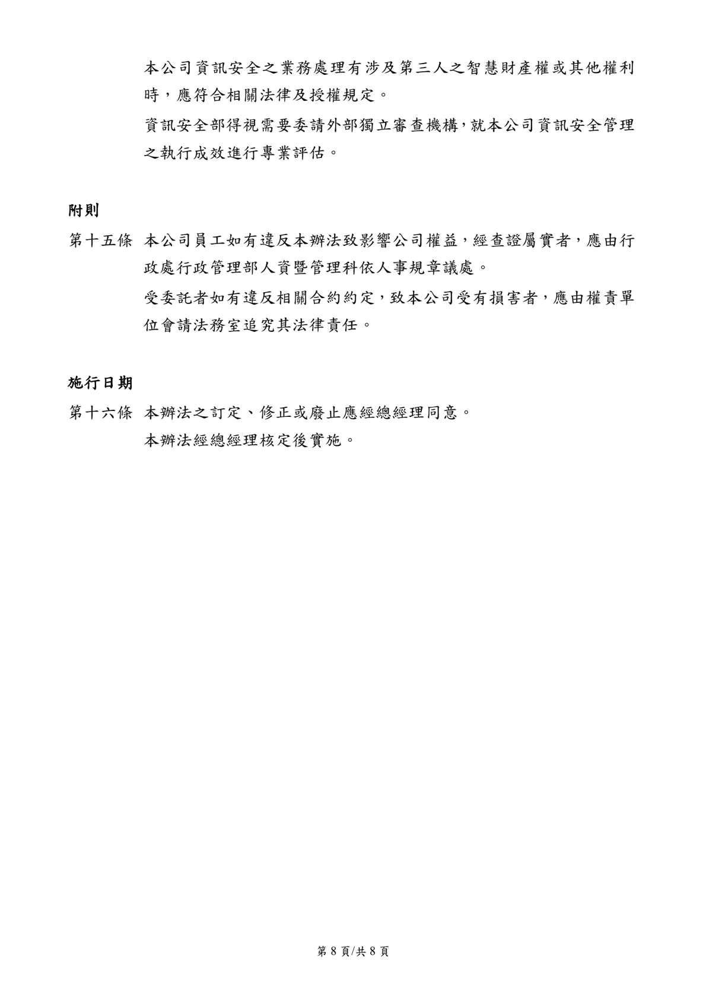

In [5]:
output_dir = Path("export_text")
output_dir.mkdir(parents=True, exist_ok=True)

for doc in doc_source:
    all_chunks = []
    #node_text, node_metadatas = [], []
    node_text = []
    conv_doc = pypdfium_converter.convert(doc).document
    print(conv_doc)

    chunk_iter = hybrid_chunker.chunk(dl_doc=conv_doc)
    chunks = list(chunk_iter)
    all_chunks += chunks

    for chunk in all_chunks:
        node_text.append(hybrid_chunker.serialize(chunk=chunk))
        #node_metadatas.append(chunk.meta.export_json_dict())
    
    # Export Text format:
    filename = Path(doc).stem
    with (output_dir / f"{filename}.txt").open("w", encoding="utf-8") as fp:
        for txt in node_text:
            fp.write(txt + "\n")
    